# HW05: Predictive Models

In [3]:
from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration, DepthProImageProcessorFast, DepthProForDepthEstimation, DPTImageProcessor, DPTForDepthEstimation
from torchvision import transforms
from diffusers import StableDiffusionImageVariationPipeline, AutoPipelineForText2Image, StableDiffusionXLImg2ImgPipeline
import torch
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

Prep for running the models on my macbook

In [4]:
torch.backends.mps.is_available()
import mlx.core as mx
print(mx.__version__)
import jax
print(jax.devices()[0])
tf.config.list_physical_devices('GPU')

Platform 'METAL' is experimental and not all JAX functionality may be correctly supported!


0.23.1
Metal device set to: Apple M3 Max

systemMemory: 128.00 GB
maxCacheSize: 48.00 GB

METAL:0


W0000 00:00:1741225163.848635 13823134 mps_client.cc:510] WARNING: JAX Apple GPU support is experimental and not all JAX functionality is correctly supported!
I0000 00:00:1741225163.848903 13823134 service.cc:145] XLA service 0x1717692a0 initialized for platform METAL (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1741225163.848911 13823134 service.cc:153]   StreamExecutor device (0): Metal, <undefined>
I0000 00:00:1741225163.852134 13823134 mps_client.cc:406] Using Simple allocator.
I0000 00:00:1741225163.852155 13823134 mps_client.cc:384] XLA backend will use up to 103077298176 bytes on device 0 for SimpleAllocator.


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Testing with a simple model for captioning

In [5]:
# https://huggingface.co/Salesforce/blip-image-captioning-base
processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to("mps")


In [6]:
img_dir = 'imgs/hog.jpg' 
img = Image.open(img_dir).convert('RGB')


In [7]:
inputs = processor(img, return_tensors="pt").to("mps")

out = model.generate(**inputs)
print(processor.decode(out[0], skip_special_tokens=True))

a hedge in the middle of a field of flowers


Trying out this Apple model for depth estimation 

In [8]:
# https://huggingface.co/apple/DepthPro-hf
device = torch.device("mps")

In [9]:
image_processor = DepthProImageProcessorFast.from_pretrained("apple/DepthPro-hf")
model = DepthProForDepthEstimation.from_pretrained("apple/DepthPro-hf").to(device)

In [10]:
inputs = image_processor(images=img, return_tensors="pt").to(device)

with torch.no_grad():
    outputs = model(**inputs)

post_processed_output = image_processor.post_process_depth_estimation(
    outputs, target_sizes=[(img.height, img.width)],
)

In [11]:
field_of_view = post_processed_output[0]["field_of_view"]
focal_length = post_processed_output[0]["focal_length"]
apple_depthpro_depth = post_processed_output[0]["predicted_depth"]
apple_depthpro_depth = (apple_depthpro_depth - apple_depthpro_depth.min()) / (apple_depthpro_depth.max() - apple_depthpro_depth.min())
apple_depthpro_depth = apple_depthpro_depth * 255.
apple_depthpro_depth = apple_depthpro_depth.detach().cpu().numpy()

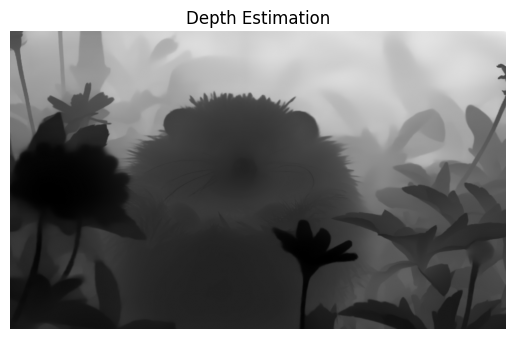

Field of View: 5.686939239501953
Focal Length: 10066.705078125


In [12]:
plt.imshow(apple_depthpro_depth.astype("uint8"), cmap='gray')
plt.title("Depth Estimation")
plt.axis('off')
plt.show()

print(f"Field of View: {field_of_view.item()}")
print(f"Focal Length: {focal_length.item()}")

Trying out a similar depth estimation model from Intel for comparison

In [13]:
processor = DPTImageProcessor.from_pretrained("Intel/dpt-large")
model = DPTForDepthEstimation.from_pretrained("Intel/dpt-large")

Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution1.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [14]:
inputs = processor(images=img, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=img.size[::-1],
    mode="bicubic",
    align_corners=False,
)

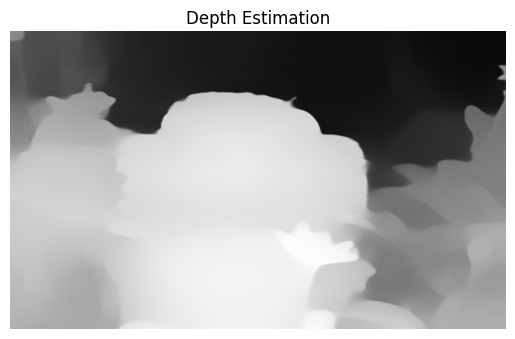

In [15]:
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
intel_dpt_depth = Image.fromarray(formatted)

plt.imshow(intel_dpt_depth, cmap='gray')
plt.title("Depth Estimation")
plt.axis('off')
plt.show()

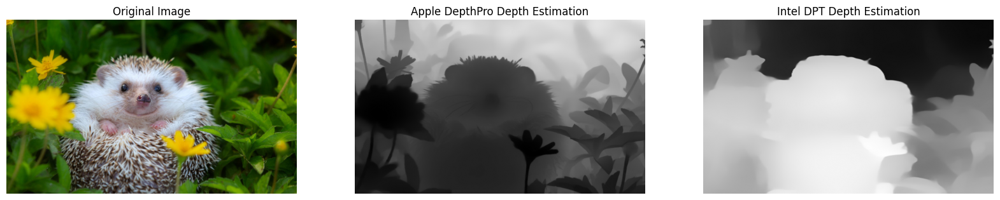

In [16]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# Plot original image
axes[0].imshow(img)
axes[0].set_title("Original Image")
axes[0].axis('off')

# Plot Apple DepthPro depth
axes[1].imshow(apple_depthpro_depth.astype("uint8"), cmap='gray')
axes[1].set_title("Apple DepthPro Depth Estimation")
axes[1].axis('off')

# Plot Intel DPT depth
axes[2].imshow(intel_dpt_depth, cmap='gray')
axes[2].set_title("Intel DPT Depth Estimation")
axes[2].axis('off')

plt.show()

Big differences between both models, the Apple Depth Pro model does a better job as you can see the details of the image while the Intel model is less clear on the details.

# Adding Diffusion Models

Going to work with the depth map generated last week and get some images out of it.

In [17]:
# https://huggingface.co/lambdalabs/sd-image-variations-diffusers
device = "mps"
sd_pipe = StableDiffusionImageVariationPipeline.from_pretrained(
  "lambdalabs/sd-image-variations-diffusers",
  revision="v2.0",
  )
sd_pipe = sd_pipe.to(device)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]An error occurred while trying to fetch /Users/matthewlaujh/.cache/huggingface/hub/models--lambdalabs--sd-image-variations-diffusers/snapshots/a2a13984e57db80adcc9e3f85d568dcccb9b29fc/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /Users/matthewlaujh/.cache/huggingface/hub/models--lambdalabs--sd-image-variations-diffusers/snapshots/a2a13984e57db80adcc9e3f85d568dcccb9b29fc/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:  33%|███▎      | 2/6 [00:00<00:00, 15.32it/s]An error occurred while trying to fetch /Users/matthewlaujh/.cache/huggingface/hub/models--lambdalabs--sd-image-variations-diffusers/snapshots/a2a13984e57db80adcc9e3f85d568dcccb9b29fc/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /Users/matthewlaujh/.cache/huggingface/hub/models--lambdalabs--sd-image-variations-diff

In [18]:
init_image = Image.fromarray(apple_depthpro_depth.astype("uint8"))
init_image = init_image.convert("RGB")

100%|██████████| 50/50 [00:11<00:00,  4.27it/s]


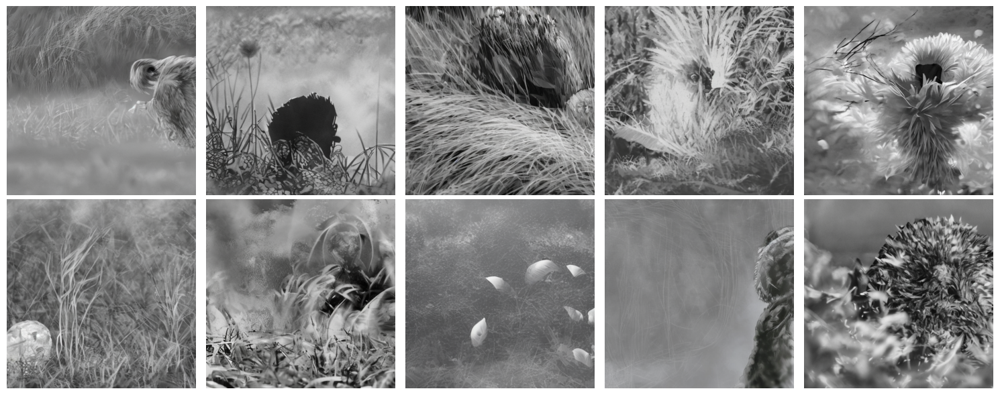

In [37]:
im = init_image
tform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(
        (224, 224),
        interpolation=transforms.InterpolationMode.BICUBIC,
        antialias=False,
        ),
    transforms.Normalize(
      [0.48145466, 0.4578275, 0.40821073],
      [0.26862954, 0.26130258, 0.27577711]),
])
inp = tform(im).to(device).unsqueeze(0)

num_variations = 10
generated_images = []

for i in range(num_variations):
    out = sd_pipe(inp, guidance_scale=0)
    generated_image = out["images"][0]
    generated_images.append(generated_image)
    generated_image.save(f"result_{i}.jpg")

fig, axes = plt.subplots(2, 5, figsize=(15, 6))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

Used a diffusion model here that generates variations of images.

~~Interesting image variations here interestingly enough, if you look at the third image on the first row, it's actually quite similar to the image of the hedgehog we started out with, it somehow recreated that image.~~
Unfortunately I accidentally re-ran the notebook and lost that image and have been trying to generate more but never got close.

In [20]:
# https://huggingface.co/stabilityai/sdxl-turbo
pipe = StableDiffusionXLImg2ImgPipeline.from_pretrained(
    "stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16"
).to("mps")

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  5.74it/s]


100%|██████████| 2/2 [00:01<00:00,  1.18it/s]


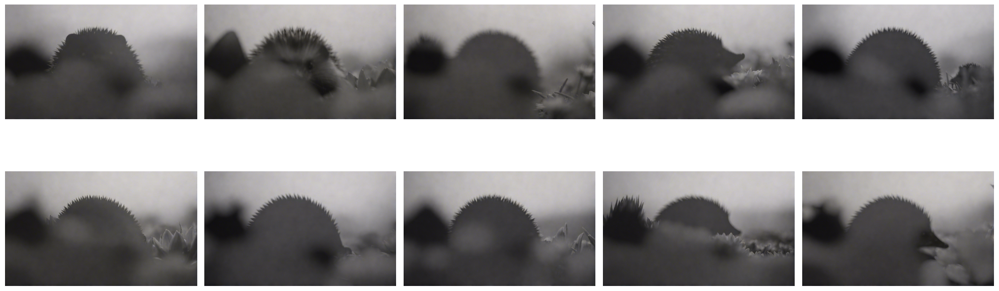

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=4, strength=0.5, guidance_scale=0.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()


100%|██████████| 2/2 [00:03<00:00,  1.76s/it]


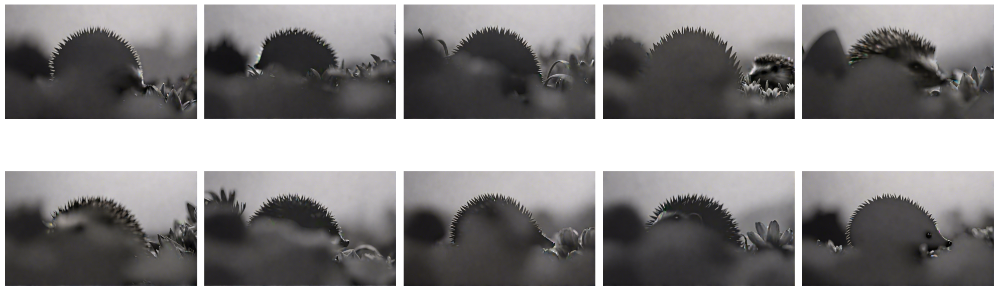

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=4, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 3/3 [00:05<00:00,  1.77s/it]


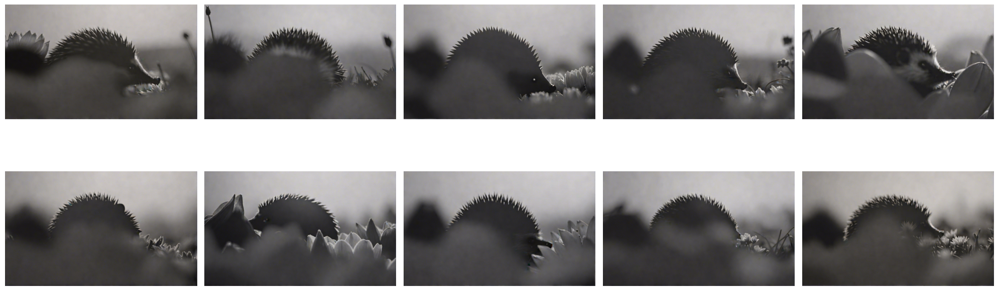

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=6, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)


fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 3/3 [00:05<00:00,  1.73s/it]
/Users/matthewlaujh/Desktop/desktop/itpnyu/itpnyu-conservationofaibasedartworks/.venv/lib/python3.10/site-packages/diffusers/image_processor.py:147: RuntimeWarning: invalid value encountered in cast
  images = (images * 255).round().astype("uint8")
100%|██████████| 3/3 [00:05<00:00,  1.74s/it]


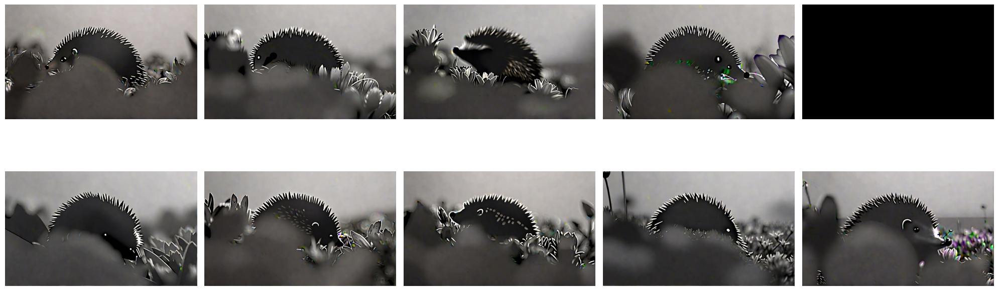

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=6, strength=0.5, guidance_scale=4.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 4/4 [00:07<00:00,  1.76s/it]


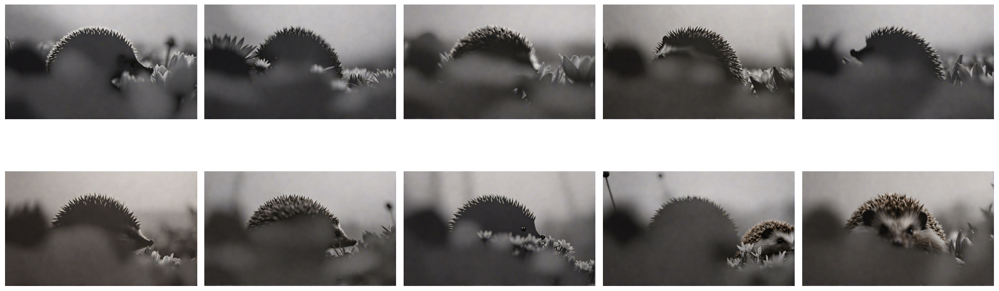

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=8, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 5/5 [00:08<00:00,  1.80s/it]


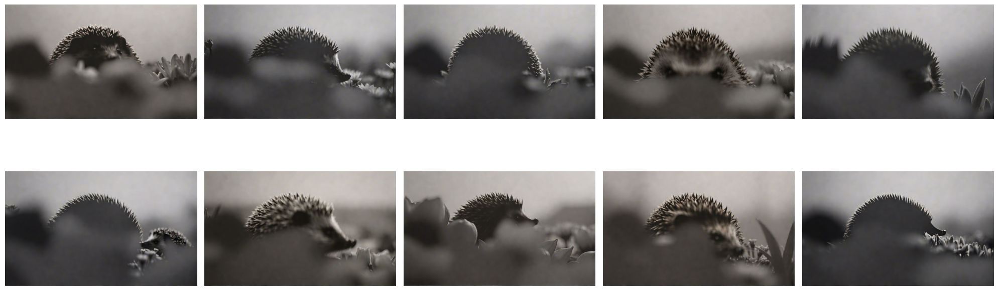

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=10, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


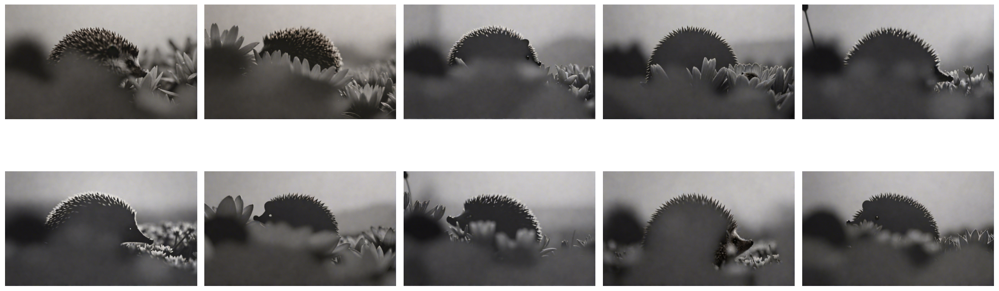

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=10, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 7/7 [00:08<00:00,  1.20s/it]


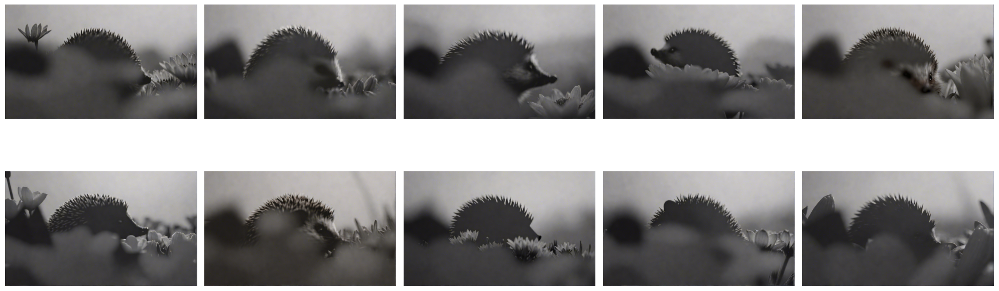

In [ ]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=15, strength=0.5, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 15/15 [00:29<00:00,  1.95s/it]


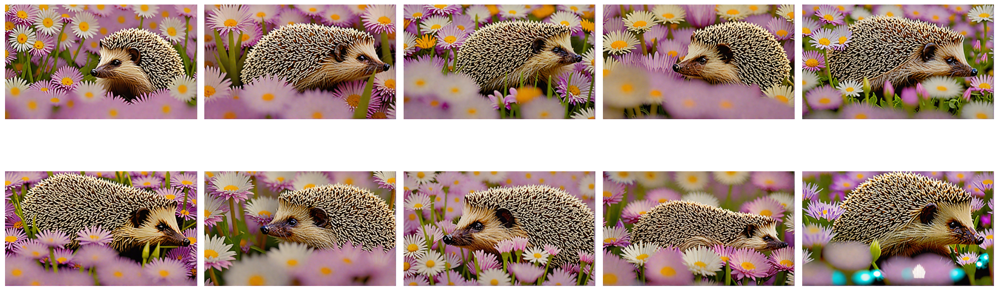

In [38]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=15, strength=1.0, guidance_scale=2.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 15/15 [00:13<00:00,  1.11it/s]


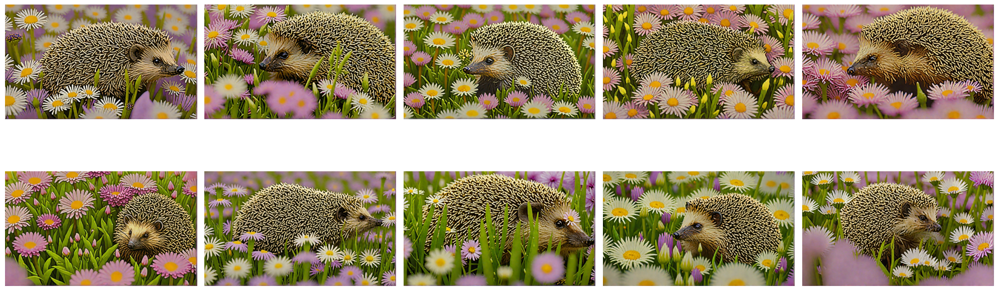

In [39]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=15, strength=1.0, guidance_scale=1.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 15/15 [00:13<00:00,  1.09it/s]
/Users/matthewlaujh/Desktop/desktop/itpnyu/itpnyu-conservationofaibasedartworks/.venv/lib/python3.10/site-packages/diffusers/image_processor.py:147: RuntimeWarning: invalid value encountered in cast
  images = (images * 255).round().astype("uint8")
100%|██████████| 15/15 [00:15<00:00,  1.02s/it]


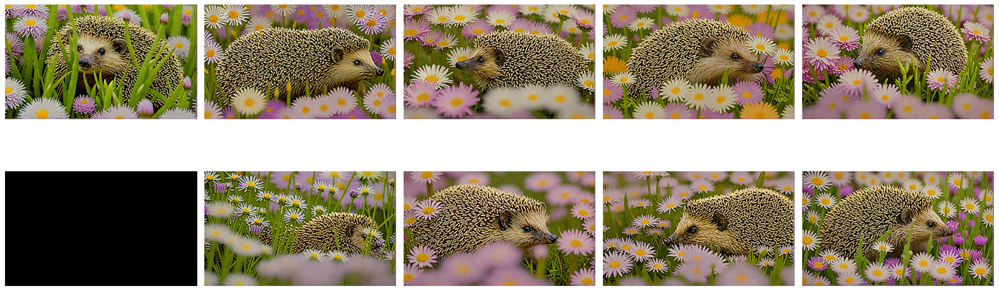

In [40]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=15, strength=1.0, guidance_scale=0.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

100%|██████████| 10/10 [00:10<00:00,  1.05s/it]


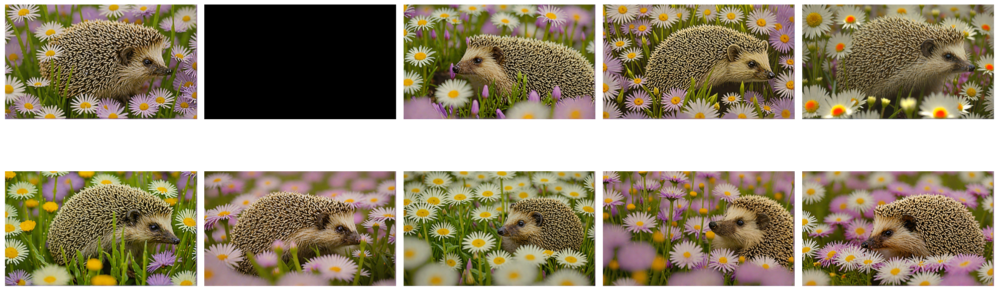

In [41]:
prompt = "A hedgehog in a bed of flowers"

num_variations = 10
generated_images = []

for i in range(num_variations):
    image = pipe(prompt=prompt, image=init_image, num_inference_steps=10, strength=1.0, guidance_scale=0.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
pipe = AutoPipelineForText2Image.from_pretrained("stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16")
pipe.to("mps")


100%|██████████| 1/1 [00:04<00:00,  4.19s/it]


100%|██████████| 1/1 [00:00<00:00,  2.06it/s]


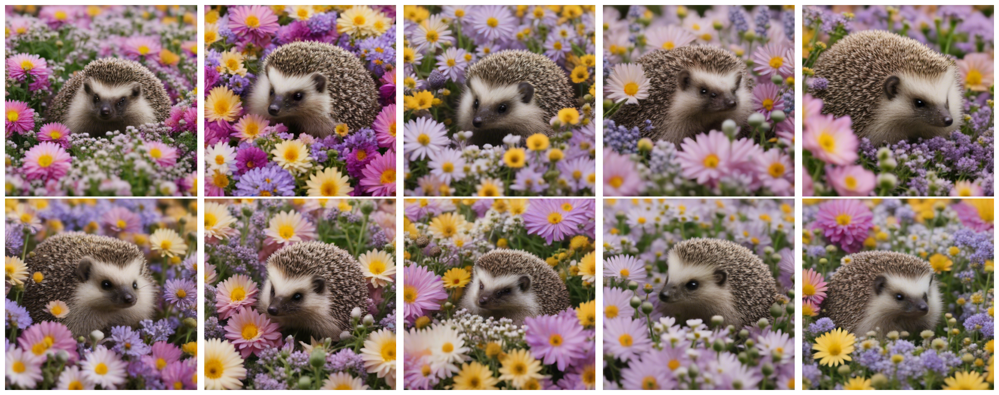

In [45]:
num_variations = 10
generated_images = []

prompt = "A hedgehog in a bed of flowers"

for i in range(num_variations):
    image = pipe(prompt=prompt, num_inference_steps=1, guidance_scale=0.0).images[0]
    generated_images.append(image)

fig, axes = plt.subplots(2, 5, figsize=(20, 8))

for ax, img in zip(axes.flat, generated_images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()


Trying the usual stable diffusion model here to try to mix prompt and image to generate some outcomes. 


Tried a couple of times to get colour outputs but it wouldn't, so decided to run with the black and white to get some outcomes.

It also took some variations in the settings to  get some decent results, mainly adjusting the inferences and guidance.

Tried to slightly tweak values each try to see the difference in results, tweaking inference helped me get closer to a composition that resembled what i wanted, tweaking strength brought back colour and tweaking guidance scale gave it some details.

While I could not achieve what I wanted just text prompting got me close.


